<h1>
<p style="text-align:center;font-size:50px">
Introduction to Geospatial Data Visualization in Python
</h1>

**This tutorial provides an introduction to geospatial data visualization using Python. It covers some basic uses of the Python library GeoPandas followed by an introduction to some other useful and FUN Python libraries for more advanced visualization examples.**

**Tutorial Outline:**

**1. Introduction to Geopandas**<br>
**2. Combining the functionality of Rasterio, Rasterstats, and Geopandas to process and visualize raster data**<br>
**3. Interactive maps with Geoviews and Holoviews**
 
**Let's make some maps!**

# 1. Introduction to Geopandas

### Data structures:

`Geoseries` and `Geodataframe`, subclasses of the pandas `Series` and `Dataframe`, respectively.

The Geoseries is a vector where each entry in the vector is a set of shapes corresponding to a single observation. Shapes include:

- Points
- Lines
- Polygons

A `GeoDataframe` is a tabular data structure that contains features and a `GeoSeries`. In plain English, the `GeoDataframe` is a pandas dataframe with a `geometry` column that contains shapes.

If you are interested in learning more about data structures or methods click here for  <a href="https://geopandas.org/">Geopandas Documentation</a>.

### 1.0 Import libraries and read in data

In [1]:
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point
import numpy as np
import contextily as ctx
import matplotlib.pyplot as plt
%matplotlib inline

#set plot parameters
plt.rcParams['figure.figsize']  = (20, 10)
plt.rcParams['axes.titlesize']  = 20
plt.rcParams['axes.labelsize']  = 16 
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14

Read in the data using `GeoPandas.read_file()`. `GeoDataFrame.to_crs()` reprojects the Coordinate Reference System (CRS), which is currently in WGS84 (EPSG=4326), geographic lat/lon degree coordinates.  Web map tiles used for background maps are typically provided in Web Mercator (EPSG=3857), planar unit coordinates. Let's reproject them now so we don't have to worry about it later on (when our script throws errors because we forgot!).

In [3]:
#Shapefile containing Columbia River subbasin shapes 
basin = gpd.read_file('../data/columbia_river_basin.shp').to_crs(epsg=3857)
#Shapefile containing Columbia River basin stream network
streams = gpd.read_file('../data/CRB_stream_network.shp').to_crs(epsg=3857)
#Stream gage locations in csv file format
gages = pd.read_csv('../data/crb_gages.csv')

### 1.1 Take a look at our geo-data structures and shapes

Geopandas reads and stores shapefile data in a `Pandas` DataFrame which is very convenient and tidy! Let's display the first three rows of the Columbia River basin and stream network `GeoDataFrames` to see what we are working with. 

In [5]:
basin

,Name,Area_sqmi,geometry
0,Lower Snake,38227,"POLYGON ((-13273890.775 5795518.645, -13273891..."
1,Upper Snake,72859,"POLYGON ((-13151035.540 5645470.326, -13150975..."
2,Lower Columbia,34191,"POLYGON ((-13550609.713 5917331.304, -13550535..."
3,Middle Columbia,30810,"POLYGON ((-13154865.971 6316548.606, -13154909..."
4,Kootenai,19345,"POLYGON ((-12945032.832 6680635.303, -12945014..."
5,Pend Oreille,26100,"POLYGON ((-13041129.364 6354697.136, -13041124..."
6,Spokane,6584,"POLYGON ((-13135561.826 6128299.010, -13135507..."
7,Upper Columbia,14432,"POLYGON ((-13317588.514 6947096.363, -13317527..."
8,Yakima,6149,"POLYGON ((-13486724.090 6039787.915, -13486716..."
9,Willamette,11215,"POLYGON ((-13648791.733 5707928.986, -13648333..."


In [6]:
streams.head(3)

,GNIS_Name,Shape_Leng,geometry
0,Banks Lake,50.057968,"LINESTRING (-13245133.483 6099383.003, -132461..."
1,Big Wood River,95.387560,"LINESTRING (-12779005.447 5303561.933, -127790..."
2,Blackfoot River,131.688656,"LINESTRING (-12524031.826 5331350.402, -125240..."


The `geometry` column contains polygon, line, or point Shapely objects. We can view these objects by indexing the `geometry` column.

In [7]:
basin.geometry[0]

We can easily plot all geometries by calling `GeoDataFrame.plot()`

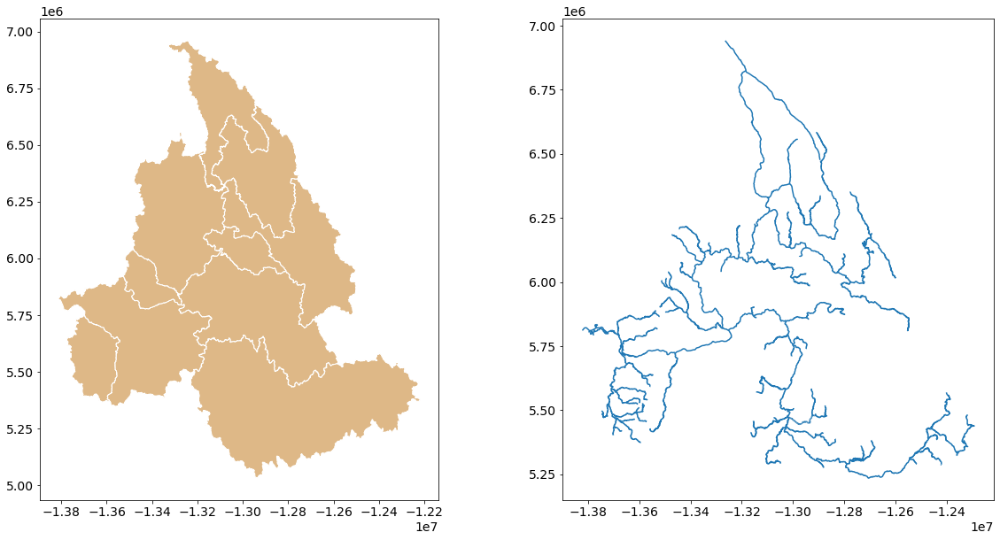

In [8]:
#map our basins and streams
fig, ax = plt.subplots(1,2)
basin.plot(edgecolor='white', color='burlywood', ax=ax[0]);
streams.plot(ax=ax[1]);

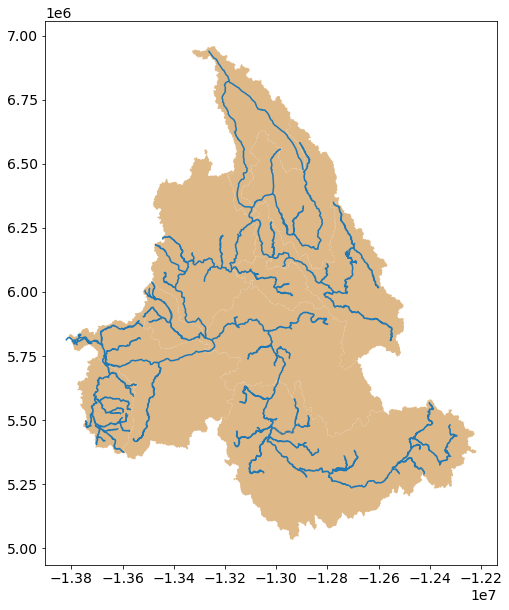

In [9]:
#map our basins and streams on same plot
fig, ax = plt.subplots()
basin.plot(color='burlywood', ax=ax);
streams.plot(ax=ax);

### 1.2 Make a `GeoDataFrame` from stream gage data

Cool! GeoPandas reads in shapefiles and stores features and geometries in a tidy DataFrame. We can also create a GeoDataFrame from the latitude and longitudes of the stream gage csv file. These stream gage locations were used by the University of Washington to project natural flows across the Columbia River basin for the <a href="https://www.bpa.gov/p/Generation/Hydro/hydro/cc/RMJOC-II-Report-Part-I.pdf">RMJOC-II climate change study</a>. If you're interested, you can find the modeled data at <a href="https://www.hydro.washington.edu/CRCC/"> UW Hydro | Columbia River Basin Climate Change</a>.

In [10]:
#take a look at the gage csv file 
gages.head(3)

,site id,longname,lat,lon
0,ALB,Albany,44.6333,-123.100000
1,ALD,Alder,46.8025,-122.310278
2,ALF,Albeni Falls,48.1822,-117.033300


In [13]:
#store gage latitiude and longitude data in a GeoPandas Series 
geom = gpd.GeoSeries([Point(x,y) for x,y in zip(gages.lon, gages.lat)])
#view list of shapely Points representing the location of each gage 
geom.head(3)

0    POINT (-123.10000 44.63330)
1    POINT (-122.31028 46.80250)
2    POINT (-117.03330 48.18220)
dtype: geometry

From the pandas dataframe and the GeoSeries we just created, we will make a `GeoDataframe` that contains geometries 
and metdata for each stream gage location. We will reproject these from latitude and longtitude coordinates 
to Web Mercator like we did with `basins` and `streams`.

In [14]:
columns = ['site id','longname']
gages_gdf = gpd.GeoDataFrame(gages[columns], geometry = geom, crs=4326)
gages_gdf = gages_gdf.to_crs(3857)
gages_gdf.head(3)

,site id,longname,geometry
0,ALB,Albany,POINT (-13703429.317 5563975.638)
1,ALD,Alder,POINT (-13615517.841 5909896.417)
2,ALF,Albeni Falls,POINT (-13028087.362 6137220.127)


Now that we have our gages `GeoDatFrame`, we can plot our subbasins, streams, and gage locations on a single map. 

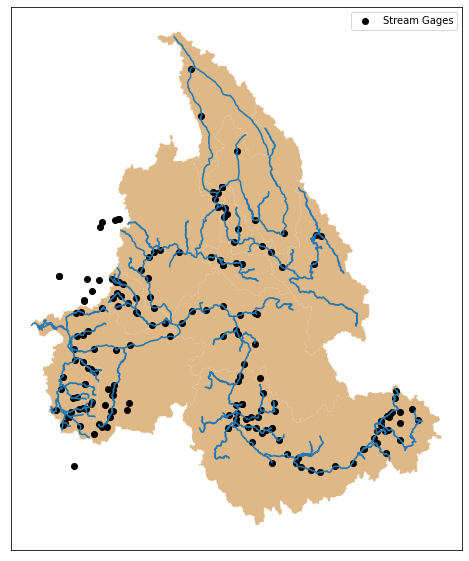

In [15]:
#turn off axes this time around, Web Mercator is not visually helpful...for me anyway. 
fig, ax = plt.subplots()
#turn off ticks and labels
ax.get_yaxis().set_visible(False)
ax.get_xaxis().set_visible(False)
#plot our geometries on the same axes: ax=ax
basin.plot(ax=ax, color='burlywood');
streams.plot(ax=ax)
gages_gdf.plot(ax=ax, color='black', label='Stream Gages')
#add a legend for gage points 
plt.legend();

### 1.3 `GeoPandas` overlays, sjoin, and the choropleth map

GeoPandas offers a variety of methods to change and merge geo-data between GeoDataFrames based on shape attributes. Let's use the boolean result of `GeoDataFrame.intersects()` to index our gage data - selecting only those locations that are within the stream network. Then we will use `gpd.sjoin()` to merge features from our stream network `streams` with our gage data `gages`.

In [16]:
len(gages_gdf)

190

In [17]:
#index gages that lie on our stream network using gages.geometry.intersects(streams.geometry)
#add a buffer of ~1/2 mile since our lat and lons did not line up exactly between datasets 
inters_bool = gages_gdf.geometry.intersects(streams.geometry.buffer(1000).unary_union)
gages_gdf = gages_gdf[inters_bool]
len(gages_gdf)

150

We cute 40 gage locations that don't lie within ~half a mile of our stream network. Now we can merge basin features with our gage data using `gpd.sjoin()`.

In [18]:
gages_gdf = gpd.sjoin(gages_gdf, basin, how='inner')

In [19]:
gages_gdf.head(3)

,site id,longname,geometry,index_right,Name,Area_sqmi
2,ALF,Albeni Falls,POINT (-13028087.362 6137220.127),5,Pend Oreille,26100
13,BDY,Boundary,POINT (-13063063.946 6272693.551),5,Pend Oreille,26100
23,BOX,Box,POINT (-13070608.934 6237801.814),5,Pend Oreille,26100


The spatial join merged features from the `streams GeoDataFrame` with the features and geometries of the `gages GeoDataFrame`. The updated dataframe includes the new column `Name` that identifies the subbasin each `Point` lies within. We can use the values of the `Name` column to color each point. This is referred to as a **`Choropleth map`**.

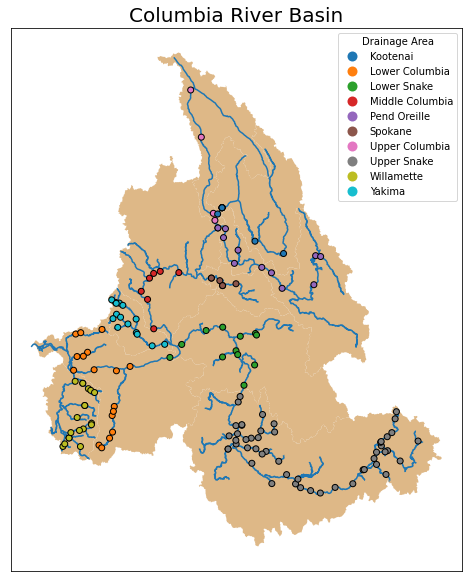

In [20]:
fig, ax = plt.subplots()
ax.get_yaxis().set_visible(False)
ax.get_xaxis().set_visible(False)

basin.plot(color='burlywood', ax=ax);
streams.plot(ax=ax)
#plot gage points and color each point by value of column='Name'
gages_gdf.plot(column='Name', ax=ax, edgecolor='black', legend=True, legend_kwds={'title': 'Drainage Area'},
               categorical=True, zorder=2)
#add title
ax.set_title('Columbia River Basin');

Cool! We made a `Choropleth map` where the colors of each `Point` correspond to the values in the `Name` column. We can also make a `Choropleth map` for our `basin` polygons using the values of `Area_sqmi`. We'll step it up another notch by adding a background map using `Contextily` and annotating our subbasins by the `Name` column. 

`Contextily` retrieves map tiles from web servers to provide map backgrounds that can be used with GeoPandas maps. You can preview and select from different web map tiles at the <a href="https://leaflet-extras.github.io/leaflet-providers/preview/"> Leaflet Provider-Previews website</a>  

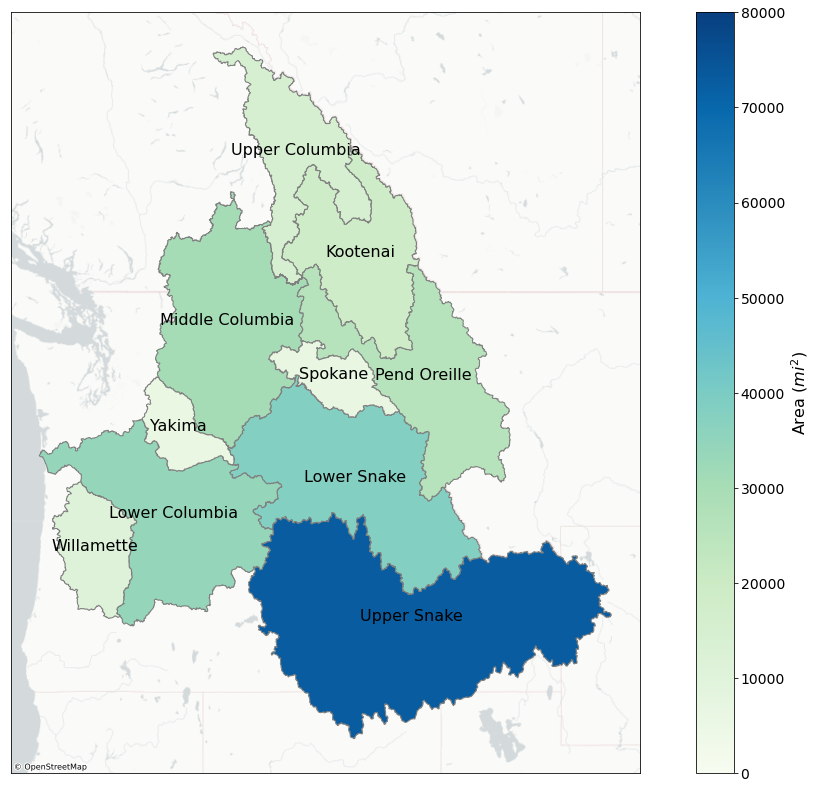

In [21]:
fig, ax = plt.subplots(figsize=[20,14])
ax.get_yaxis().set_visible(False)
ax.get_xaxis().set_visible(False)

#plot our basin and color each polygon by Area_sqmi 
basin.plot(column='Area_sqmi', cmap='GnBu', edgecolor='gray', vmin=0, vmax=80000,legend=True, ax=ax, legend_kwds={'label': "Area ($mi^2$)"});

#Add a map background using contextily
ctx.add_basemap(ax, source='https://{s}.basemaps.cartocdn.com/light_nolabels/{z}/{x}/{y}{r}.png', 
                attribution="\N{COPYRIGHT SIGN} OpenStreetMap");

#annotate our map using the labels in the Name column and x,y centroid of each polygon
for x, y, label in zip(basin.centroid.x, basin.centroid.y, basin.Name):
    ax.annotate(label, xy=(x,y), horizontalalignment='center', fontsize=16);

# 2. Rasterio, Rasterstats, GeoPandas to process and visualize raster data

### 2.0 Import rasterio and rasterstats and read in raster of 2010 monthly precipitation 

Rasterio opens and reads gridded data as a GeoTiff raster. Let's use rasterio to look at gridded high-resolution Columbia River basin monthly precipitation for water year 2010. Original data came from the  <a href="https://psl.noaa.gov/data/gridded/data.livneh.html">Livneh daily precipitation dataset</a>.

In [22]:
import rasterio
import rasterio.plot as rioplot
import rasterstats as rs

In [24]:
#rasterio reads netcdf data as a raster
prec = rasterio.open('../data/prec_monthly_2010.nc') 

In [28]:
#data is monthly data for water year 2010 so this raster has 12 bands
#we can look at metadata for a single band
prec.tags(1)

{'NETCDF_DIM_time': '0',
 'NETCDF_VARNAME': 'Monthly Precipitation (mm)',
 '_FillValue': 'nan'}

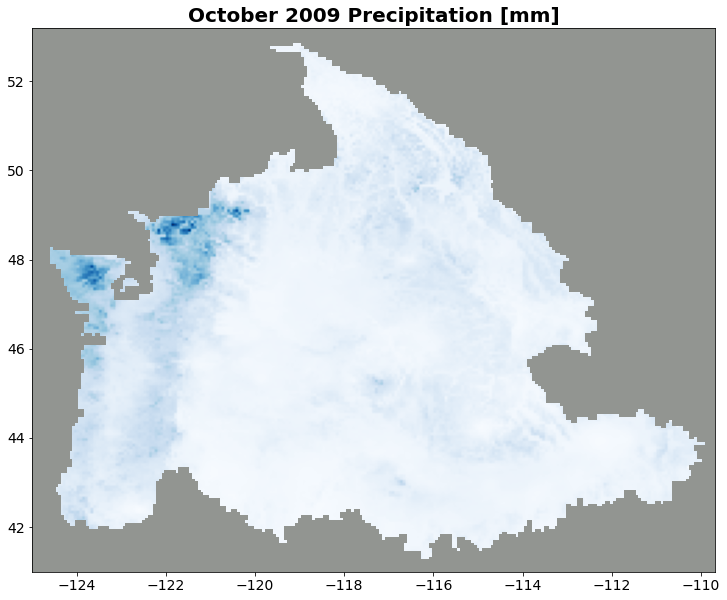

In [29]:
fig, ax = plt.subplots(figsize=[20,10])
#plot data for first band of raster, pass precip.read(1) to rioplot.show()
#band 1 corresponds to the first timestep of our dataset, January monthly precipitation
rioplot.show(prec.read(1), ax=ax, with_bounds=True, transform=prec.transform, 
             cmap=plt.cm.Blues, title='October 2009 Precipitation [mm]')
#set background to gray so raster is easier to see
ax.set_facecolor('xkcd:gray')

### 2.1 Use `Rasterstats` to average gridded monthly precipitation over our basin polygons

`Rasterstats` works with any raster data source supported by `Rasterio` to provide zonal summary statistics including `max`, `min`, `median`, and `min` for polygons. Zonal statistics are calculated across grid cells where the cell center point is ***within*** the polygon. This is a very cool tool that allows us to transfer gridded data to our polygons! This section was adapted from <a href="https://geohackweek.github.io/vector/06-geopandas-advanced/">Emilio Mayorga's 2019 WaterHackWeek GeoPandas Advanced Topics tutorial</a>.

We will use `Rasterstats` to calculate zonal mean monthly precipitation for each of our subbasins. We can store `Rasterstats` output in a `GeoDatFrame` for easy plotting of output. Our gridded data is in WGS84 (lat/lon) - let's start by reprojecting our `basin GeoDataFrame` to the same CRS.

In [30]:
#reproject basins to WGS84 coordinate reference systen
basin = basin.to_crs(epsg=4326)
basin.head(3)

,Name,Area_sqmi,geometry
0,Lower Snake,38227,"POLYGON ((-119.24139 46.09458, -119.24139 46.0..."
1,Upper Snake,72859,"POLYGON ((-118.13776 45.15192, -118.13723 45.1..."
2,Lower Columbia,34191,"POLYGON ((-121.72720 46.84820, -121.72653 46.8..."


In [31]:
#define raster band to calculate summary statistics on (band 1 = October precip)
rast_band = prec.read(1)
#define georeference transform - this is required by Rasterstats.zonal_stats()  
affine = prec.transform
# call Rasterstats.zonal_stats() to cal polygon-averaged monthly precipitation 
mean_prec_gjson = rs.zonal_stats(basin, rast_band, affine=affine, prefix='Oct2010_precip_', 
                                 geojson_out=True, stats='mean', nodata=np.nan)
#create a GeoDataFrame from features of mean_prec_gjson
mean_prec_gdf = gpd.GeoDataFrame.from_features(mean_prec_gjson, crs=4326)

In [32]:
mean_prec_gdf.head(3)

,geometry,Area_sqmi,Name,Oct2010_precip_mean
0,"POLYGON ((-119.24139 46.09458, -119.24139 46.0...",38227,Lower Snake,60.165034
1,"POLYGON ((-118.13776 45.15192, -118.13723 45.1...",72859,Upper Snake,55.105884
2,"POLYGON ((-121.72720 46.84820, -121.72653 46.8...",34191,Lower Columbia,78.503970


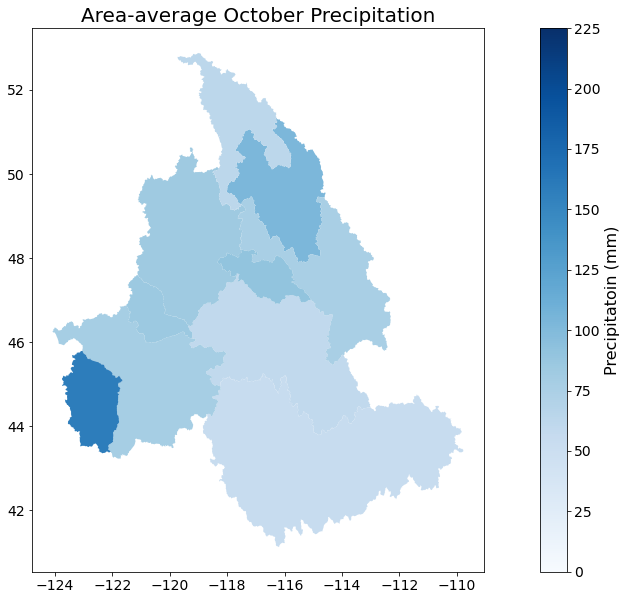

In [33]:
fig, ax = plt.subplots(figsize=[20, 10])
mean_prec_gdf.plot(column='Oct2010_precip_mean', ax=ax, cmap=plt.cm.Blues, vmin=0, vmax=225, legend=True,
               legend_kwds={'label': "Precipitatoin (mm)"})
plt.title('Area-average October Precipitation');

# 3. `GeoViews` and `HoloViews` for interactive maps!

`GeoViews` is a library that can be used to easily visualize geospatial data over large domains. Geographic plot types are based on the geoprocessing library `Cartopy`. `HoloViews` is a plotting library that has many cool features/functions - the coolest of which is the ability to make interactive plots. We will use `GeoViews` and `HoloViews` to make an interactive map of our monthly precipitation. This section was adapted from <a href="https://github.com/UW-Hydro"> Andrew Bennett's 2019 UW WaterHackWeek MetSim tutorial</a>. 

### 3.0 Import libraries

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
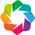

In [34]:
import geoviews as gv
import holoviews as hv
import cartopy
gv.extension('bokeh')

### 3.1 Make a function that applies `Rasterstats` to our polygons for whichever month we are intersted in outputs a `GeoViews` interactive map. 

In Section 2.1 we plotted the zonal mean using `Rasterstats` for a single raster band that corresponded to monthly precipitation at timestep 1 (October). Recall we did this by reading in the first band: prec.read(1). Now we will create a function that allows us to select and plot any of our 12 timesteps by using a dictionary of keys (months) mapped to raster bands (prec raster data). First we need to create the dictionary.

In [35]:
#list of months
month = ['Oct', 'Nov', 'Dec', 'Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep']
#list of raster bands at timesteps 1 through 12
rast_band = [prec.read(i) for i in range(1,13)]
#create dictionary that maps months to raster bands 
prec_month = dict(zip(month, rast_band))

Now that we have out dictionary of months and raster arrays we can define a function that: 
1. Takes a string month (e.g. 'Jan') and calculates zonal mean monthly precip for each of our polygons
2. Stores the subbasin name and precip values in a GeoDataFrame for input to our interactive mapper
3. Uses `GeoViews` to output an interactive map 

In [36]:
def plot_raster2poly_prec(month):
    
    #zonal_stat_gjson = geoJSON of zonal mean precipitation for each polygon at timestep month 
    mean_prec_gjson = rs.zonal_stats(basin, prec_month[month], affine=affine, 
                                 prefix='WY2010_precip_', stats='mean', geojson_out=True, nodata=np.nan)
    #zonal_gdf = zonal_stat_gjson stored in a GeoDataFrame
    mean_prec_gdf = gpd.GeoDataFrame.from_features(mean_prec_gjson, crs=4326)
    #index the Name and precip2010_mean columns for input to our mapper
    mean_prec_gdf = mean_prec_gdf[['Name', 'WY2010_precip_mean']]
    #shapes = an iterator of shapely geometries from our basin shapefile
    shapes = cartopy.io.shapereader.Reader('../data/columbia_river_basin.shp')
    #GeoViews interactive map
    #on=key to join shapes with our geo_df
    #index=name of subbasin when we hover over
    #value=values to be plotted
    poly = gv.Shape.from_records(shapes.records(), mean_prec_gdf, on='Name', value='WY2010_precip_mean', index='Name')
    #GeoViews interactive map options 
    poly = (gv.tile_sources.EsriTerrain * poly.opts(width=700, height=700,cmap=plt.cm.Blues, tools=['hover'], colorbar=True,
    alpha=0.7).redim.range(precip2010_mean=(0,350)))

    return poly

In [37]:
plot_raster2poly_prec('Jan')

:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]   (Name,WY2010_precip_mean)

### 3.1 Use `HoloViews` to make it even more interactive! 

Ok, that's really cool but it's a pain to plot each month separately. Let's make another dictionary that maps months to our plotting function and use `HoloViews` to generate an interactive toolbar. This plot will render inline; however, it eventually kills my kernel. We will save this as an html file and view in the browser to be safe. 

In [38]:
%%time
mapping = {month: plot_raster2poly_prec(month) for month in month}
hvmap = hv.HoloMap(mapping, kdims='Month').redim.values(Month=month)
hv.save(hvmap, 'hvmap.html')

Wall time: 5min                                                                                                        
